In [1]:
#Instalação dos Pacotes, caso não tenha
#!pip install dataprep
#!pip install xgboost
#!pip install lightgbm

# Importar Bibliotecas
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Importar Relatórios Dataprep
from dataprep.eda import create_report, plot_correlation

# Importação de Ferramentas
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.metrics import roc_auc_score, roc_curve, accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
from sklearn.model_selection import RandomizedSearchCV
from mlxtend.plotting import plot_confusion_matrix
import imblearn
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler, SMOTE

# Importação dos modelos
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.model_selection import StratifiedKFold, cross_val_score
from xgboost import XGBClassifier
import lightgbm as lgb

# Desabilitar avisos
import warnings
warnings.filterwarnings('ignore')

NumExpr defaulting to 8 threads.


In [2]:
dataset = pd.read_csv('COVID.csv', delimiter=',')

In [3]:
dataset.head()

,Unnamed: 0,sex,patient_type,intubed,pneumonia,age,pregnancy,diabetes,copd,asthma,inmsupr,hypertension,other_disease,cardiovascular,obesity,renal_chronic,tobacco,contact_other_covid,covid_res,icu
0,0,0,1,NaN,0.0,27,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,NaN
1,1,0,1,NaN,0.0,24,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,1,NaN
2,2,1,0,0.0,0.0,54,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,NaN,1,0.0
3,3,0,0,0.0,1.0,30,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,1,0.0
4,4,1,0,0.0,0.0,60,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,NaN,1,0.0


## Etapa 1 - Preparação dos Dados e Verificação de Consistência

In [4]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 499692 entries, 0 to 499691
Data columns (total 20 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   Unnamed: 0           499692 non-null  int64  
 1   sex                  499692 non-null  int64  
 2   patient_type         499692 non-null  int64  
 3   intubed              107424 non-null  float64
 4   pneumonia            499681 non-null  float64
 5   age                  499692 non-null  int64  
 6   pregnancy            245258 non-null  float64
 7   diabetes             498051 non-null  float64
 8   copd                 498246 non-null  float64
 9   asthma               498250 non-null  float64
 10  inmsupr              498030 non-null  float64
 11  hypertension         498203 non-null  float64
 12  other_disease        497499 non-null  float64
 13  cardiovascular       498183 non-null  float64
 14  obesity              498222 non-null  float64
 15  renal_chronic    

In [5]:
# verificar itens duplicaddos
dataset.duplicated().value_counts()

False    499692
dtype: int64

In [6]:
#Retirando a coluna de identificação do paciente para não inferir a overfiting
dataset = dataset.drop(columns='Unnamed: 0')

In [7]:
# Percentual de dados faltantes
dataset.isnull().mean()*100

sex                     0.000000
patient_type            0.000000
intubed                78.501957
pneumonia               0.002201
age                     0.000000
pregnancy              50.918166
diabetes                0.328402
copd                    0.289378
asthma                  0.288578
inmsupr                 0.332605
hypertension            0.297984
other_disease           0.438870
cardiovascular          0.301986
obesity                 0.294181
renal_chronic           0.295382
tobacco                 0.315995
contact_other_covid    30.753944
covid_res               0.000000
icu                    78.502157
dtype: float64

In [8]:
list = ['intubed', 'pregnancy', 'contact_other_covid', 'icu']

In [9]:
# variaveis com muitos registros nulos e que deverão ser tratadas
for i in list:
    reg = dataset[i].isnull().sum()
    print(f'Coluna: \033[1m{i.upper()}\033[0m - Valores Nulos: \033[1m{reg}\033[0m')
    

Coluna: INTUBED - Valores Nulos: 392268
Coluna: PREGNANCY - Valores Nulos: 254434
Coluna: CONTACT_OTHER_COVID - Valores Nulos: 153675
Coluna: ICU - Valores Nulos: 392269


In [10]:
dataset.describe()

,sex,patient_type,intubed,pneumonia,age,pregnancy,diabetes,copd,asthma,inmsupr,hypertension,other_disease,cardiovascular,obesity,renal_chronic,tobacco,contact_other_covid,covid_res,icu
count,499692.000000,499692.000000,107424.000000,499681.000000,499692.000000,245258.000000,498051.000000,498246.000000,498250.000000,498030.000000,498203.000000,497499.000000,498183.000000,498222.000000,498216.000000,498113.000000,346017.000000,499692.000000,107423.000000
mean,0.493492,0.784775,0.084739,0.157533,42.545942,0.014736,0.125186,0.016610,0.032542,0.016206,0.163267,0.030939,0.022921,0.164443,0.020110,0.086235,0.569238,0.441586,0.083865
std,0.499958,0.410978,0.278494,0.364302,16.640391,0.120492,0.330930,0.127806,0.177434,0.126267,0.369609,0.173152,0.149653,0.370677,0.140376,0.280712,0.495184,0.496577,0.277186
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,1.000000,0.000000,0.000000,31.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,1.000000,0.000000,0.000000,41.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000
75%,1.000000,1.000000,0.000000,0.000000,53.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,120.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


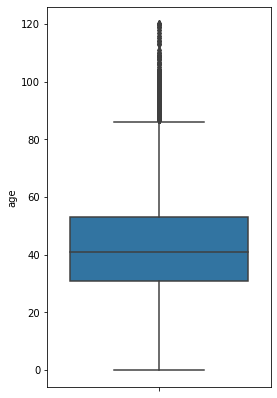

In [11]:
# Boxplot para verificar a categorização da idade
fig = plt.figure(figsize=(4,7))
sns.boxplot(y='age', data=dataset);

In [12]:
dataset1 = dataset.copy()

In [13]:
#Categorizar numericamente a coluna idade (age)
dataset1['age'] = np.where(dataset['age'] < np.quantile(dataset['age'], 0.25), 0, 
                 np.where(dataset['age'] < np.quantile(dataset['age'], 0.50), 1,
                 np.where(dataset['age'] < np.quantile(dataset['age'], 0.75), 2, 3)))

In [14]:
dataset1['age'].value_counts(sort = False)

0    122307
1    120831
2    126901
3    129653
Name: age, dtype: int64

In [15]:
# Distribuição de registros nas categorias que mais tem nulo 
for i in list:
    print(dataset1[i].value_counts())

0.0    98321
1.0     9103
Name: intubed, dtype: int64
0.0    241644
1.0      3614
Name: pregnancy, dtype: int64
1.0    196966
0.0    149051
Name: contact_other_covid, dtype: int64
0.0    98414
1.0     9009
Name: icu, dtype: int64


In [16]:
# Proporção de registros nas categorias que mais tem nulos em relação a terem ou não covid
# Que serão utilizados para os preenchimentos dos NaN
for i in list:
    print(dataset1[[i]][dataset1['covid_res'] == 1].value_counts(normalize=True))

intubed
0.0        0.903989
1.0        0.096011
dtype: float64
pregnancy
0.0          0.985631
1.0          0.014369
dtype: float64
contact_other_covid
1.0                    0.53197
0.0                    0.46803
dtype: float64
icu
0.0    0.914646
1.0    0.085354
dtype: float64


### Tratamento  da coluna Intubed

In [17]:
# Inconsistência nos dados iniciais de pacientes intubados sem terem COVID
dataset1['intubed'][(dataset1['intubed'] == 1) & (dataset1['covid_res'] == 0)].value_counts()

1.0    2554
Name: intubed, dtype: int64

In [18]:
# Correção dos valores inconsistentes em intubados
dataset1[(dataset1['intubed'] == 1) & (dataset1['covid_res'] == 0)] = 0

In [19]:
# Valores de intubação preenchidos
dataset1['intubed'].value_counts()

0.0    100875
1.0      6549
Name: intubed, dtype: int64

In [20]:
# Valores de intubação não preenchidos ou nulos
dataset1['intubed'].isnull().value_counts()

True     392268
False    107424
Name: intubed, dtype: int64

In [21]:
# Registros nulos sem covid
dataset1['intubed'][(dataset1['intubed'].isnull()) & (dataset1['covid_res'] == 0)].size

239822

In [22]:
# Correção dos registros nulos sem covid para o parametro de intubação = 0
dataset1['intubed'][(dataset1['intubed'].isnull()) & (dataset1['covid_res'] == 0)] = 0 

In [23]:
# Número de registros nulos em relação a idade com covid
dataset1[['intubed', 'age']][(dataset1['intubed'].isnull()) & (dataset1['covid_res'] == 1)].size

304892

In [24]:
# Proporção dos registros por idade não nulos em que as pessoas foram intubadas 
dataset1[['intubed', 'age']][(dataset1['intubed'] == 1) & (dataset1['covid_res'] == 1)].value_counts(normalize=True)

intubed  age
1.0      3      0.646053
         2      0.230570
         1      0.078485
         0      0.044892
dtype: float64

In [25]:
# Máscara do registros nulos com covid e separado por faixa etária
mask = dataset1[['intubed', 'age']][(dataset1['intubed'].isnull()) & (dataset1['covid_res'] == 1) & (dataset1['age'] == 3)]
mask1 = dataset1[['intubed', 'age']][(dataset1['intubed'].isnull()) & (dataset1['covid_res'] == 1) & (dataset1['age'] == 2)]
mask2 = dataset1[['intubed', 'age']][(dataset1['intubed'].isnull()) & (dataset1['covid_res'] == 1) & (dataset1['age'] == 1)]
mask3 = dataset1[['intubed', 'age']][(dataset1['intubed'].isnull()) & (dataset1['covid_res'] == 1) & (dataset1['age'] == 0)]

In [26]:
# Array de proporções por faixa etária
prop = dataset1[['intubed', 'age']][(dataset1['intubed'] == 1) & (dataset1['covid_res'] == 1)].value_counts(normalize=True).values

In [27]:
prop

array([0.64605283, 0.23056955, 0.07848526, 0.04489235])

In [28]:
# Correção dos intubados nulos em proporção aos não nulos
dataset1['intubed'][:round(mask.shape[0]*prop[0])] = 1
dataset1['intubed'][:round(mask1.shape[0]*prop[1])] = 1
dataset1['intubed'][:round(mask2.shape[0]*prop[2])] = 1
dataset1['intubed'][:round(mask3.shape[0]*prop[3])] = 1

In [29]:
dataset1['intubed'].value_counts()

0.0    335323
1.0     26981
Name: intubed, dtype: int64

### Tratamento da coluna Pregnancy

In [30]:
# Não existe inconsistência nos registros de gravidez sendo masculino
dataset1['pregnancy'][(dataset1['pregnancy'] == 1 ) & (dataset1['sex'] == 0)]

Series([], Name: pregnancy, dtype: float64)

In [31]:
# Se não esta com covid, não é relevante se esta gravida
dataset1['pregnancy'][(dataset1['pregnancy'].isnull()) & (dataset1['covid_res'] == 0)] = 0

In [32]:
# Numero de registros de gravidez nulas com covid
mask_preg = dataset1['pregnancy'][(dataset1['pregnancy'].isnull()) & (dataset1['covid_res'] == 1)]
mask_preg.size

121483

In [33]:
# Proporção do dataset original de mulheres gravidas e com covid
prop1 = dataset['pregnancy'].value_counts(normalize=True)
prop1

0.0    0.985264
1.0    0.014736
Name: pregnancy, dtype: float64

In [34]:
# Correção dos nulos em proporção ao Dataset original do numero de gravidas com covid
dataset1['pregnancy'][:round(mask_preg.shape[0]*prop1[1])] = 1

In [35]:
dataset1['pregnancy'].value_counts()

0.0    373781
1.0      5383
Name: pregnancy, dtype: int64

### Tratamento da coluna Contact_Other_Covid

In [36]:
## Se não esta com covid, não é relevante o contato 
dataset1['contact_other_covid'][(dataset1['contact_other_covid'].isnull()) & (dataset1['covid_res'] == 0)] = 0

In [37]:
# Numero de registros de contatos com outras pessoas nulos com covid 
mask_coc = dataset1['contact_other_covid'][(dataset1['contact_other_covid'].isnull()) & (dataset1['covid_res'] == 1)]
mask_coc.size

81025

In [38]:
# Proporção do dataset original de contaminação provavel por contato com outra pessoa com covid
prop2 = dataset['contact_other_covid'].value_counts(normalize=True)
prop2

1.0    0.569238
0.0    0.430762
Name: contact_other_covid, dtype: float64

In [39]:
# Correção dos nulos em proporção ao Dataset original do numero de contatos de pessoas com covid
dataset1['contact_other_covid'][:round(mask_coc.shape[0]*prop2[0])] = 1

In [40]:
dataset1['contact_other_covid'].value_counts()

1.0    219946
0.0    211795
Name: contact_other_covid, dtype: int64

### Tratamento da coluna ICU

In [41]:
dataset1['icu'].isnull().sum()

392269

In [42]:
# Numero de inconsistências nos registros de internação na UTI sem ter covid
dataset1['icu'][(dataset1['icu'].isnull()) & (dataset1['covid_res'] == 0)].size

239822

In [43]:
# Correção nos registros de internação sem covid
dataset1['icu'][(dataset1['icu'].isnull()) & (dataset1['covid_res'] == 0)] = 0

In [44]:
#Numero de registros de internação nulos com covid
mask_icu = dataset1['icu'][(dataset1['icu'].isnull()) & (dataset1['covid_res'] == 1)]
mask_icu.size

152447

In [45]:
# Proporção do dataset original de internações na UTI com covid
prop3 = dataset['icu'].value_counts(normalize=True)
prop3

0.0    0.916135
1.0    0.083865
Name: icu, dtype: float64

In [46]:
# Correção dos nulos em proporção ao Dataset original do numero de internções UTI com covid
dataset1['icu'][:round(mask_icu.shape[0]*prop3[1])] = 1

In [47]:
dataset1['icu'].value_counts()

0.0    336496
1.0     20205
Name: icu, dtype: int64

### Tratamento Final do Dataset

In [48]:
dataset1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 499692 entries, 0 to 499691
Data columns (total 19 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   sex                  499692 non-null  int64  
 1   patient_type         499692 non-null  int64  
 2   intubed              362304 non-null  float64
 3   pneumonia            499681 non-null  float64
 4   age                  499692 non-null  int32  
 5   pregnancy            379164 non-null  float64
 6   diabetes             498103 non-null  float64
 7   copd                 498296 non-null  float64
 8   asthma               498299 non-null  float64
 9   inmsupr              498085 non-null  float64
 10  hypertension         498249 non-null  float64
 11  other_disease        497581 non-null  float64
 12  cardiovascular       498234 non-null  float64
 13  obesity              498266 non-null  float64
 14  renal_chronic        498266 non-null  float64
 15  tobacco          

In [49]:
# Após a correção dos registros nulos, o restante será incluido 0
dataset1.fillna(0, inplace=True)

In [50]:
dataset1 = dataset1.astype(int)

In [51]:
dataset1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 499692 entries, 0 to 499691
Data columns (total 19 columns):
 #   Column               Non-Null Count   Dtype
---  ------               --------------   -----
 0   sex                  499692 non-null  int32
 1   patient_type         499692 non-null  int32
 2   intubed              499692 non-null  int32
 3   pneumonia            499692 non-null  int32
 4   age                  499692 non-null  int32
 5   pregnancy            499692 non-null  int32
 6   diabetes             499692 non-null  int32
 7   copd                 499692 non-null  int32
 8   asthma               499692 non-null  int32
 9   inmsupr              499692 non-null  int32
 10  hypertension         499692 non-null  int32
 11  other_disease        499692 non-null  int32
 12  cardiovascular       499692 non-null  int32
 13  obesity              499692 non-null  int32
 14  renal_chronic        499692 non-null  int32
 15  tobacco              499692 non-null  int32
 16  co

#### Resumo da 1º Etapa

Na 1º etapa do processo fiz inúmeros ajustes no banco de dados da Covid, pois existiam muitos registros nulos e inconsistentes. 
Decidi seguir os seguintes caminhos:

Para a coluna Age:

Por ser continua decidi categorizar em 4 classes separadas pelos quartis 25, 50, 75 e demais.

Para as 4 maiores categorias com dados faltantes:   
 (Intubed, Pregnacy, Contact_Other_Covid e ICU:
 
1º Intubed    
•	Corrigi a inconsistência em dados onde o paciente estava como intubado, porém, sem estar com covid;   
•	Corrigi os dados nulos sem covid para não intubados;   
•	Corrigi proporcionalmente os registros nulos e idade categorizada que estavam com covid;   
•	Por fim o restante como não encontrei mais nenhuma relação decidi adicionar 0.   

2º Pregnancy  
•	Verifiquei se existia inconsistência entre estar gravida, mas ser homem, mas não havia;  
•	Corrigi os campos dos pacientes que não estavam com covid para não gravidez, por não ser relevante ao target;  
•	Corrigi proporcionalmente os registros nulos com covid na mesma proporção dos que já estavam preenchidos.  
•	Por fim o restante como não encontrei mais nenhuma relação decidi adicionar 0.  

3º Contact_Other_Covid  
•	Corrigi os registros dos pacientes que não estavam com covid para 0 por entender ser insignificante para o target; 
•	 Corrigi proporcionalmente os registros nulos com covid na mesma proporção dos que já estavam preenchidos;  
•	Por fim o restante como não encontrei mais nenhuma relação decidi adicionar 0.  

4º ICU  
•	Corrigi a inconsistência em dados onde o paciente estava internado na UTI, porém, sem estar com covid;  
•	Corrigi proporcionalmente os registros nulos com covid na mesma proporção dos que já estavam preenchidos;  
•	Por fim o restante como não encontrei mais nenhuma relação decidi adicionar 0.  

E por fim ajustei as colunas para int para diminuir o tamanho do dataset.

In [52]:
dataset_clean = dataset1.copy()

## Etapa 2 - Análise Exploratória dos Dados

In [53]:
dataset_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 499692 entries, 0 to 499691
Data columns (total 19 columns):
 #   Column               Non-Null Count   Dtype
---  ------               --------------   -----
 0   sex                  499692 non-null  int32
 1   patient_type         499692 non-null  int32
 2   intubed              499692 non-null  int32
 3   pneumonia            499692 non-null  int32
 4   age                  499692 non-null  int32
 5   pregnancy            499692 non-null  int32
 6   diabetes             499692 non-null  int32
 7   copd                 499692 non-null  int32
 8   asthma               499692 non-null  int32
 9   inmsupr              499692 non-null  int32
 10  hypertension         499692 non-null  int32
 11  other_disease        499692 non-null  int32
 12  cardiovascular       499692 non-null  int32
 13  obesity              499692 non-null  int32
 14  renal_chronic        499692 non-null  int32
 15  tobacco              499692 non-null  int32
 16  co

  0%|                                                                                         | 0/1696 [00:00<…

DataPrep Report
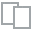
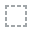
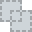
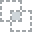
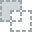
...
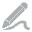
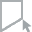
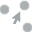
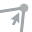
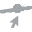

In [54]:
# Relatório Automatizado
create_report(dataset_clean)

100%|############################################################################################| 4/4 [00:00<…


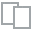
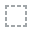
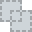
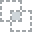
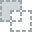
...
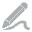
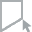
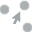
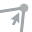
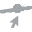

In [55]:
# Relatório de Correlação
plot_correlation(dataset_clean)

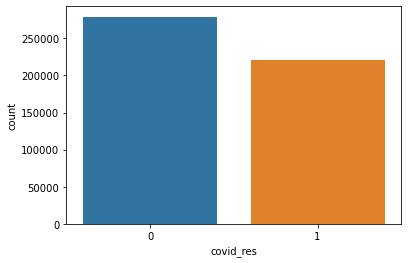

In [56]:
# Gráfico de balanceamento da base de dados
sns.countplot(dataset_clean['covid_res']);

#### Resumo da 2º Etapa

2º Etapa do processo – Relatório Dataprep

O Overview já traz inúmeras informações sobre o dataset mas em especial devo salientar que o numero de colunas duplicadas demostrado é devido a retirada do índice dos pacientes, e como o dataset é categorizado em 0 e 1 e tem um grande volume de informações, a possibilidade de parâmetros iguais é inevitável.

Na parte de Variables, fica evidente o desbalanceamento de várias variáveis e o preenchimento total do dataset.

Em interações o Dataprep para este dataset não é relevante.

Em correlações pode-se verificar interativamente os dados nas 3 principais ferramentas de correlação: Pearson, Sperman e KendallTau. Demonstrando que a maior correlação positiva foi entre intubed x ICU e a maior correlação negativa foi entre patient_type x pneumonia e que a média da correlação entre as várias variáveis foi de 0,031.

Por fim um plot do balanceamento dos dados da variável target.

## Etapa 3 - Modelagem dos Dados

In [57]:
def test_models_plot_roc_auc_curve(model_list, col_model_name, col_model, X_train, X_test, y_train, y_test):
    fig = plt.figure(figsize=(10, 7))
    for mdl in model_list:
        model = mdl[col_model]
        model.fit(X_train, y_train)
        y_predict = model.predict(X_test)
        fpr, tpr, thresholds = metrics.roc_curve(y_test, model.predict_proba(X_test)[:,1])
        auc = metrics.roc_auc_score(y_test, model.predict(X_test))
        plt.plot(fpr, tpr, label='%s ROC (AUC = %0.2f)' % (mdl[col_model_name], auc))
        print("Model      : %s" % mdl[col_model_name])
        print("Accuracy   : %0.4f " %  accuracy_score(y_test, y_predict))
        print("Precision  : %0.4f " % precision_score(y_test, y_predict, average='weighted'))
        print("Recall     : %0.4f " % recall_score(y_test, y_predict, average='weighted'))
        print("F1 - Score : %0.4f " % f1_score(y_test, y_predict, average='weighted'))
        print("ROC - AUC  : %0.4f " % auc)
        print("======================")
    plt.plot([0, 1], [0, 1],'r--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC-AUC curve')
    plt.legend(loc="lower right")
    plt.show()

### Teste com 8 modelos de Machine Learning

In [58]:
random_seed = 42

list_models = [
{'model_name': 'Decision Tree',
 'estimator' : DecisionTreeClassifier(random_state = random_seed)},
{'model_name': 'LogisticRegression',
 'estimator' : LogisticRegression(random_state = random_seed)},
{'model_name': 'LinearDiscriminantAnalysis',
 'estimator' : LinearDiscriminantAnalysis()},
{'model_name': 'Random Forest',
 'estimator' : RandomForestClassifier(random_state = random_seed)}, 
{'model_name': 'AdaBoost',
 'estimator' : AdaBoostClassifier(random_state = random_seed)},
{'model_name': 'GradientBoosting',
 'estimator' : GradientBoostingClassifier(random_state = random_seed)},
{'model_name': 'XGBoost',
 'estimator' : XGBClassifier(eval_metric='mlogloss', random_state = random_seed)},
{'model_name': 'LightGBM',
 'estimator' : lgb.LGBMClassifier(random_state = random_seed)},
]

### Feature Selection

,Peso_%,Acumulado
intubed,29.442566,29.442566
pneumonia,14.260949,43.703515
patient_type,12.458549,56.162065
age,12.337658,68.499723
icu,7.851446,76.351169
contact_other_covid,3.168903,79.520072
diabetes,2.901518,82.421590
obesity,2.893627,85.315217
sex,2.503209,87.818426
hypertension,2.038962,89.857388


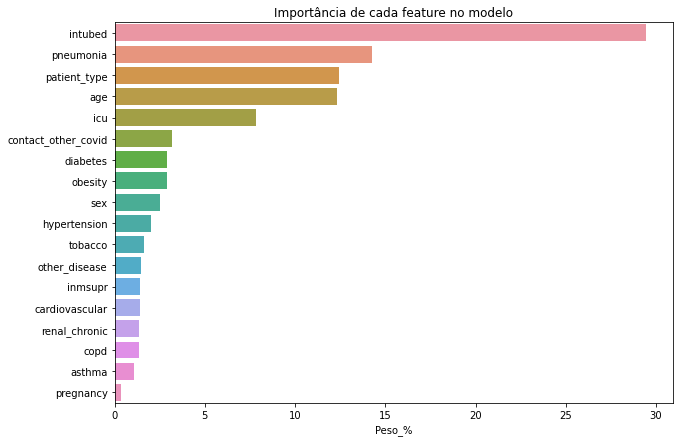

In [59]:
# Avaliar o peso de cada variavel para o modelo
X = dataset_clean.drop(['covid_res'], axis = 1)
y = dataset_clean['covid_res']

modelo = RandomForestClassifier()
modelo.fit(X, y)

# Print dos Resultados
df_peso = pd.DataFrame((modelo.feature_importances_)*100, columns = ['Peso_%'], index=X.columns)
df_peso = df_peso.sort_values(by=['Peso_%'], ascending= False)
df_peso['Acumulado'] = df_peso['Peso_%'].cumsum()
display(df_peso)

fig = plt.figure(figsize=(10, 7))
sns.barplot(x=df_peso['Peso_%'], y=df_peso.index, orient='h').set_title('Importância de cada feature no modelo')
plt.show()

In [60]:
X = dataset_clean.drop(['tobacco','inmsupr', 'copd', 'other_disease', 'renal_chronic', 'cardiovascular', 'asthma', 'pregnancy', 'covid_res'], axis = 1)
y = dataset_clean['covid_res']

### Redução das Variaveis

    Os Modelos performados com todas as variaveis (18) não adicionaram valor significativo ao resultado
    porém aumentaram o custo computacional.
    
    Os Modelos performados com aproximadamente 90% ou 10 variaveis, não diminuiram significativamente os 
    resultados (0,005) porém diminuiram significativamente o custo operacional na validação cruzada.
    


### Amostragem - Resampling - Dados de Treino e de Teste

In [61]:
#Separando em train e test
X_train, X_test, y_train, y_test = train_test_split(X, 
                                                    y, 
                                                    test_size=0.35, 
                                                    random_state=42,
                                                    stratify=y)

In [62]:
#Normalizando os dados
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

Model      : Decision Tree
Accuracy   : 0.6658 
Precision  : 0.6806 
Recall     : 0.6658 
F1 - Score : 0.6423 
ROC - AUC  : 0.6375 
Model      : LogisticRegression
Accuracy   : 0.6596 
Precision  : 0.6753 
Recall     : 0.6596 
F1 - Score : 0.6336 
ROC - AUC  : 0.6301 
Model      : LinearDiscriminantAnalysis
Accuracy   : 0.6607 
Precision  : 0.6807 
Recall     : 0.6607 
F1 - Score : 0.6322 
ROC - AUC  : 0.6299 
Model      : Random Forest
Accuracy   : 0.6658 
Precision  : 0.6803 
Recall     : 0.6658 
F1 - Score : 0.6426 
ROC - AUC  : 0.6377 
Model      : AdaBoost
Accuracy   : 0.6597 
Precision  : 0.6768 
Recall     : 0.6597 
F1 - Score : 0.6329 
ROC - AUC  : 0.6298 
Model      : GradientBoosting
Accuracy   : 0.6655 
Precision  : 0.6804 
Recall     : 0.6655 
F1 - Score : 0.6420 
ROC - AUC  : 0.6372 
Model      : XGBoost
Accuracy   : 0.6659 
Precision  : 0.6803 
Recall     : 0.6659 
F1 - Score : 0.6427 
ROC - AUC  : 0.6378 
Model      : LightGBM
Accuracy   : 0.6658 
Precision  : 0.6811 
Re

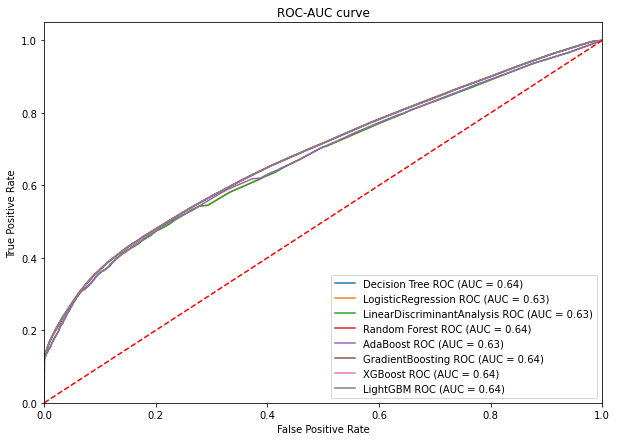

In [63]:
#Testando todos os modelos
test_models_plot_roc_auc_curve(list_models,
                              "model_name",
                              "estimator",
                              X_train,
                              X_test,
                              y_train,
                              y_test)

### Balanceamento dos Dados

In [64]:
# Utilizando com um dos modelos de melhor ROC_AUC 
model = RandomForestClassifier(random_state = 42)

In [65]:
# Utilizando Oversample para balanceamento dos dados
oversample = RandomOverSampler(sampling_strategy='minority')
X_train_ov, y_train_ov = oversample.fit_resample(X_train, y_train)
model.fit(X_train_ov, y_train_ov)
y_pred_ov = model.predict(X_test)
acc_over = roc_auc_score(y_test, y_pred_ov)

In [66]:
# Utilizando Undersample para balanceamento dos dados
undersample = RandomUnderSampler(sampling_strategy='majority')
X_train_un, y_train_un = undersample.fit_resample(X_train, y_train)
model.fit(X_train_un, y_train_un)
y_pred_un = model.predict(X_test)
acc_under = roc_auc_score(y_test, y_pred_un)

In [67]:
# Utilizando SMOTE para balanceamento dos dados
smote = SMOTE()
X_train_sm, y_train_sm = smote.fit_resample(X_train, y_train)
model = RandomForestClassifier(random_state = 42)
model.fit(X_train_sm, y_train_sm)
y_pred_sm = model.predict(X_test)
acc_smote = roc_auc_score(y_test, y_pred_sm)

In [68]:
print("Comparação das Acurácias: ")
print('ROC_AUC com Oversampling:  ', np.round(acc_over, 6))
print('ROC_AUC com Undersampling: ', np.round(acc_under, 6))
print('ROC_AUC com SMOTE:         ', np.round(acc_smote, 6))

Comparação das Acurácias: 
ROC_AUC com Oversampling:   0.639783
ROC_AUC com Undersampling:  0.639732
ROC_AUC com SMOTE:          0.639958


No balanciamento dos dados utilizando o SMOTE, a performance da curva ROC_AUC teve um incremento
de quase 0,25%, ou seja, nada significativo em relação aos dados originais, mas decidi continuar
com os dados balanceados pelo SMOTE.

### Cross Validation

In [69]:
# Grid dos melhores modelos
best_models = [
{'model_name': 'Decision Tree',
 'estimator' : DecisionTreeClassifier(random_state = random_seed)},
{'model_name': 'Random Forest',
 'estimator' : RandomForestClassifier(random_state = random_seed)},
{'model_name': 'XGBoost      ',
 'estimator' : XGBClassifier(eval_metric='mlogloss', random_state = random_seed)},
{'model_name': 'LightGBM     ',
 'estimator' : lgb.LGBMClassifier(random_state = random_seed)},
]

Modelo         ROC_AUC  Desvio Padrão
Decision Tree: 0.686714 (0.002324)
Random Forest: 0.686733 (0.002327)
XGBoost      : 0.687085 (0.002370)
LightGBM     : 0.687324 (0.002262)


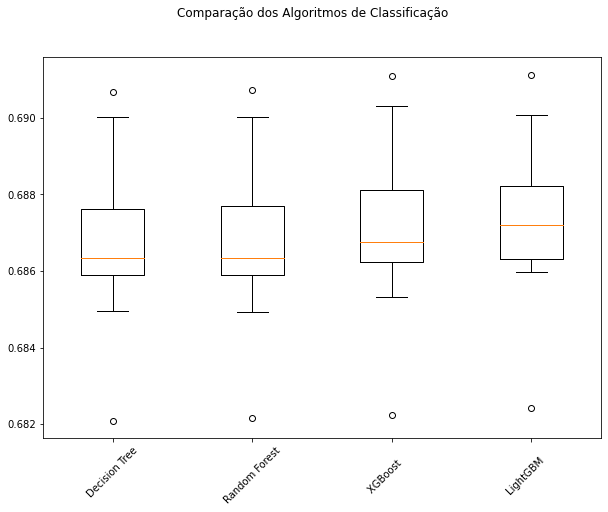

In [70]:
# Validação Cruzada com os 4 melhores resultados de ROC_AUC

num_folds = 10
seed = 42

resultados = []
nomes = []
count = 0

for mdl in best_models:
    model = mdl['estimator']
    kfold = StratifiedKFold(num_folds, True, random_state = seed)
    cv_results = cross_val_score(model, X_train_sm, y_train_sm, cv = kfold, scoring = 'roc_auc')
    resultados.append(cv_results)
    nomes.append(best_models[count]['model_name'])
    if count == 0:
        print('\033[1mModelo         ROC_AUC  Desvio Padrão\033[0m')
    msg = "%s: %f (%f)" % (best_models[count]['model_name'], cv_results.mean(), cv_results.std())
    print(msg)
    count += 1
    
    
# Boxplot para comparar os algoritmos
fig = plt.figure(figsize=(10, 7))
fig.suptitle('Comparação dos Algoritmos de Classificação')
ax = fig.add_subplot(111)
plt.boxplot(resultados)
ax.set_xticklabels(nomes, rotation = 45)
plt.show()

### RandomizedSearchCV Parameter Tuning

In [72]:
### Gerando os parametros para o GRID

# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 5)]

# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 100, num = 5)]
max_depth.append(None)

# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]

# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]

# Create the random grid
params_grid = {'criterion': ['gini', 'entropy'],
               'n_estimators': n_estimators,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf}

print(params_grid)

{'criterion': ['gini', 'entropy'], 'n_estimators': [200, 650, 1100, 1550, 2000], 'max_depth': [10, 32, 55, 77, 100, None], 'min_samples_split': [2, 5, 10], 'min_samples_leaf': [1, 2, 4]}


In [73]:
# DecisionTreeClassifier com os melhores parâmetros

num_folds = 10
seed = 42

# Separando os dados em folds
kfold = StratifiedKFold(num_folds, True, random_state = seed)

# Criando o modelo
modelo_dt = DecisionTreeClassifier(criterion = 'gini', 
                                max_depth = 10, 
                                min_samples_split = 10, 
                                min_samples_leaf = 4, 
                                random_state = 42)
# Cross Validation
resultado = cross_val_score(modelo_dt, X_train_sm, y_train_sm, cv = kfold, scoring = 'roc_auc')

dt_res = resultado.mean() * 100

# Print do resultado
print("ROC_AUC: %.3f" % (resultado.mean() * 100))

ROC_AUC: 68.695


In [74]:
DecisionTreeClassifier_BestHip = 'ROC_AUC: 68.695'

In [75]:
# RandomForestClassifier com os melhores parâmetros

num_folds = 10
seed = 42

# Separando os dados em folds
kfold = StratifiedKFold(num_folds, True, random_state = seed)

# Criando o modelo
modelo_rf = RandomForestClassifier(criterion = 'entropy', 
                                max_depth = 10, 
                                min_samples_split = 5, 
                                min_samples_leaf = 4, 
                                random_state = 42)

# Cross Validation
resultado = cross_val_score(modelo_rf, X_train_sm, y_train_sm, cv = kfold, scoring = 'roc_auc')

rf_res = resultado.mean() * 100

# Print do resultado
print("ROC_AUC: %.3f" % (resultado.mean() * 100))

ROC_AUC: 68.720


In [76]:
RandomForestClassifier_BestHip = 'ROC_AUC: 68.720'

In [77]:
# XGBClassifier com os melhores parâmetros

num_folds = 10
seed = 42

# Separando os dados em folds
kfold = StratifiedKFold(num_folds, True, random_state = seed)

# Criando o modelo
modelo_xgb = XGBClassifier(eval_metric='mlogloss', 
                       colsample_bytree = 0.7, 
                       learning_rate = 0.01, 
                       max_depth = 6, 
                       n_estimators = 500, 
                       random_state = 42)
 
# Cross Validation
resultado = cross_val_score(modelo_xgb, X_train_sm, y_train_sm, cv = kfold, scoring = 'roc_auc')

xgb_res = resultado.mean() * 100

# Print do resultado
print("ROC_AUC: %.3f" % (resultado.mean() * 100))

ROC_AUC: 68.748


In [78]:
XGBClassifier_BestHip = 'ROC_AUC: 68.748'

In [79]:
# LGBMClassifier com os melhores parâmetros

num_folds = 10
seed = 42

# Separando os dados em folds
kfold = StratifiedKFold(num_folds, True, random_state = seed)

# Criando o modelo
modelo_lgbm = lgb.LGBMClassifier(colsample_bytree = 0.7524720294039439,
                            max_depth = 9, 
                            min_child_samples = 20,
                            min_child_weight = 0.1,
                            num_leaves = 31,
                            reg_alpha = 3,
                            reg_lambda = 4,
                            subsample = 0.5854127159187904,
                            random_state = 42)
 
# Cross Validation
resultado = cross_val_score(modelo_lgbm, X_train_sm, y_train_sm, cv = kfold, scoring = 'roc_auc')

lgbm_res = resultado.mean() * 100

# Print do resultado
print("ROC_AUC: %.3f" % (resultado.mean() * 100))

ROC_AUC: 68.740


In [80]:
LGBMClassifier_BestHip = 'ROC_AUC: 68.740'

In [81]:
print("Comparação dos Resultados: ")
print('ROC_AUC DecisionTreeClassifier: ', np.round(dt_res, 4), '%')
print('ROC_AUC RandomForestClassifier: ', np.round(rf_res, 4), '%')
print('ROC_AUC XGBClassifier         : ', np.round(xgb_res, 4), '%')
print('ROC_AUC LGBMClassifier        : ', np.round(lgbm_res, 4), '%')

Comparação dos Resultados: 
ROC_AUC DecisionTreeClassifier:  68.6945 %
ROC_AUC RandomForestClassifier:  68.7201 %
ROC_AUC XGBClassifier         :  68.7477 %
ROC_AUC LGBMClassifier        :  68.7402 %


In [82]:
modelo_dt.fit(X_train_sm, y_train_sm)
modelo_rf.fit(X_train_sm, y_train_sm)
modelo_xgb.fit(X_train_sm, y_train_sm)
modelo_lgbm.fit(X_train_sm, y_train_sm)

y_pred_dt = modelo_dt.predict(X_test)
y_pred_rf = modelo_rf.predict(X_test)
y_pred_xgb = modelo_xgb.predict(X_test)
y_pred_lgbm = modelo_lgbm.predict(X_test)

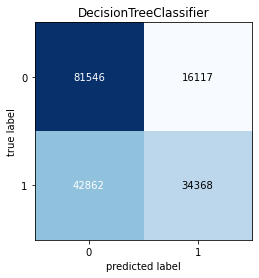

In [83]:
cm = confusion_matrix(y_test, y_pred_dt)
plot_confusion_matrix(conf_mat=cm)
plt.title(label='DecisionTreeClassifier')
plt.show()

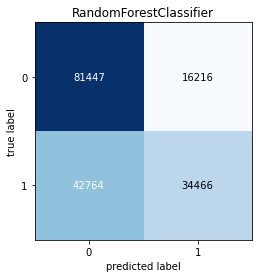

In [84]:
cm = confusion_matrix(y_test, y_pred_rf)
plot_confusion_matrix(conf_mat=cm)
plt.title(label='RandomForestClassifier')
plt.show()

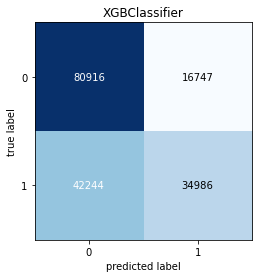

In [85]:
cm = confusion_matrix(y_test, y_pred_xgb)
plot_confusion_matrix(conf_mat=cm)
plt.title(label='XGBClassifier')
plt.show()

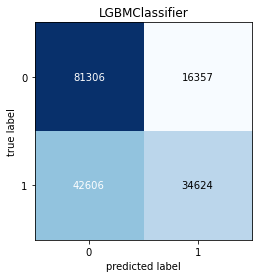

In [86]:
cm = confusion_matrix(y_test, y_pred_lgbm)
plot_confusion_matrix(conf_mat=cm)
plt.title(label='LGBMClassifier')
plt.show()

In [89]:
print(classification_report(y_test, y_pred_xgb))

              precision    recall  f1-score   support

           0       0.66      0.83      0.73     97663
           1       0.68      0.45      0.54     77230

    accuracy                           0.66    174893
   macro avg       0.67      0.64      0.64    174893
weighted avg       0.67      0.66      0.65    174893



### Avaliação de Thresholds

In [90]:
# Criando o predict proba para a base de teste
y_proba_test = modelo_xgb.predict_proba(X_test)
y_proba_test

array([[0.5891975 , 0.41080248],
       [0.5091708 , 0.49082926],
       [0.5023651 , 0.49763492],
       ...,
       [0.47128636, 0.52871364],
       [0.6506736 , 0.3493264 ],
       [0.61286795, 0.38713208]], dtype=float32)

In [91]:
# trazer a resposta para junto das probabilidades
results_test = pd.DataFrame(y_test)

# Pegando a probabilidade em estar com COVID (classe 1)
results_test['proba'] = np.round(y_proba_test[:,1], 3)

In [92]:
# Criando um dataframe com a probabilidade da classe 1 e a marcação de target
results_test.head()

,covid_res,proba
410165,0,0.411
355256,0,0.491
155861,1,0.498
114370,1,0.678
332085,0,0.598


In [93]:
# Parâmetros para o Looping

threshold_increment  = 0.02
threshold_begin = threshold_increment
threshold_end    = 1.0

In [94]:
# Para cada threshold, no looping calcula TN, FN, FP, TP e outras métricas

list_threshold  = []
list_TN         = []
list_FN         = []
list_FP         = []
list_TP         = []
list_precision  = []
list_recall     = []
list_accuracy   = []
list_f1_score   = []

for i in np.arange(threshold_begin, threshold_end + threshold_increment, threshold_increment):
    i_threshold = np.round(i, 2)
    print(str(i_threshold) + ' ', end = '')
    
    results_test['y_pred'] = results_test['proba'].apply(lambda x: 1 if x >= i_threshold else 0)
    results_test['flag_TN'] = np.where((results_test['y_pred'] == 0) & (results_test['covid_res'] == 0), 1, 0)
    results_test['flag_FN'] = np.where((results_test['y_pred'] == 0) & (results_test['covid_res'] == 1), 1, 0)
    results_test['flag_TP'] = np.where((results_test['y_pred'] == 1) & (results_test['covid_res'] == 1), 1, 0)
    results_test['flag_FP'] = np.where((results_test['y_pred'] == 1) & (results_test['covid_res'] == 0), 1, 0)
  
    TN = results_test['flag_TN'].sum()
    FN = results_test['flag_FN'].sum()
    TP = results_test['flag_TP'].sum()
    FP = results_test['flag_FP'].sum()
    
    precision = np.where((TP + FP) > 0, TP / (TP + FP), 0)
    recall = np.where((TP + FN) > 0, TP / (TP + FN), 0)
    accuracy = np.where((TN + FN + TP + FP) > 0, 
                         (TP + TN)/(TN + FN + TP + FP), 0)
    f1_score = np.where((precision + recall) > 0, (2 * precision * recall)/(precision + recall), 0)
    
    list_threshold.append(i_threshold)
    list_TN.append(TN)
    list_FN.append(FN)
    list_FP.append(FP)
    list_TP.append(TP)
    list_precision.append(np.round(precision, 4))
    list_recall.append(np.round(recall, 4))
    list_accuracy.append(np.round(accuracy, 4))
    list_f1_score.append(np.round(f1_score, 4))

#---------------------
dict_output = {
  "threshold" : list_threshold, 
  "TN" : list_TN,
  "FN" : list_FN,
  "FP" : list_FP,
  "TP" : list_TP,
  "precision" : list_precision,
  "recall" : list_recall,
  "accuracy" : list_accuracy,
  "f1_score" : list_f1_score
}

df_results = pd.DataFrame(dict_output)

0.02 0.04 0.06 0.08 0.1 0.12 0.14 0.16 0.18 0.2 0.22 0.24 0.26 0.28 0.3 0.32 0.34 0.36 0.38 0.4 0.42 0.44 0.46 0.48 0.5 0.52 0.54 0.56 0.58 0.6 0.62 0.64 0.66 0.68 0.7 0.72 0.74 0.76 0.78 0.8 0.82 0.84 0.86 0.88 0.9 0.92 0.94 0.96 0.98 1.0 

In [95]:
# Avaliando os resultados
df_results

,threshold,TN,FN,FP,TP,precision,recall,accuracy,f1_score
0,0.02,0,0,97663,77230,0.4416,1.0000,0.4416,0.6126
1,0.04,0,0,97663,77230,0.4416,1.0000,0.4416,0.6126
2,0.06,0,0,97663,77230,0.4416,1.0000,0.4416,0.6126
3,0.08,0,0,97663,77230,0.4416,1.0000,0.4416,0.6126
4,0.10,0,0,97663,77230,0.4416,1.0000,0.4416,0.6126
5,0.12,0,0,97663,77230,0.4416,1.0000,0.4416,0.6126
6,0.14,0,0,97663,77230,0.4416,1.0000,0.4416,0.6126
7,0.16,0,0,97663,77230,0.4416,1.0000,0.4416,0.6126
8,0.18,0,0,97663,77230,0.4416,1.0000,0.4416,0.6126
9,0.20,1519,184,96144,77046,0.4449,0.9976,0.4492,0.6153


In [96]:
# Escolhido threshold 0.36 devido ao maior f1-score
y_pred_th = np.where(y_proba_test[:,1] >= 0.36, 1, 0)
y_pred_th

array([1, 1, 1, ..., 1, 0, 1])

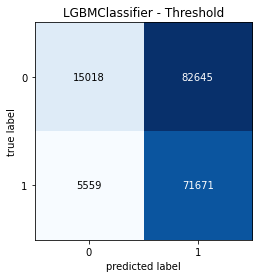

In [97]:
cm = confusion_matrix(y_test, y_pred_th)
plot_confusion_matrix(conf_mat=cm)
plt.title(label='LGBMClassifier - Threshold')
plt.show()

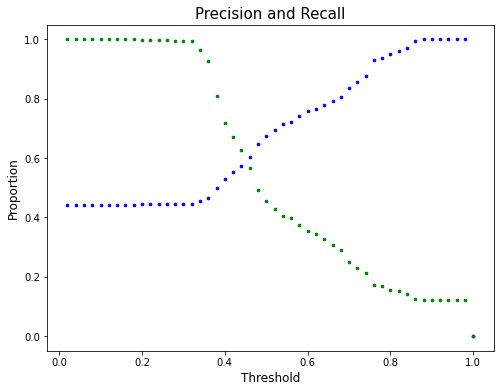

In [98]:
# Precison-Recall-Threshold Curve

# variavel de proporção para os gráficos
k = 2

# Define o tamanho da figura
fig = plt.figure(figsize = (k*4,k*3))

# Definindo a janela de plot
ax1 = fig.add_subplot(111)

# Scatter do Precision
ax1.scatter(df_results['threshold'], df_results['precision'], color = 'b', s = 7)

# Scatter do Recall
ax1.scatter(df_results['threshold'], df_results['recall']   , color = 'g', s = 7)

# Configurações dos exiso
ax1.set_xlabel('Threshold', fontsize = 12)
ax1.set_ylabel('Proportion', fontsize = 12)

# Cria titulo
plt.title("Precision and Recall", fontsize = 15)

# Mostra o gráfico
plt.show()

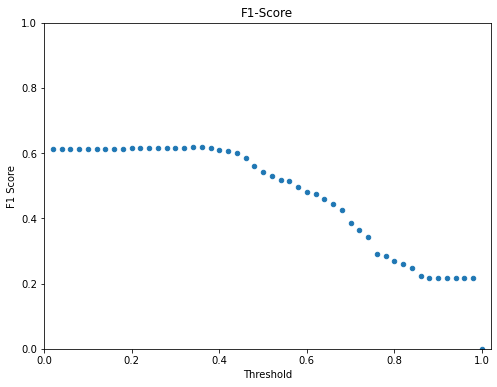

In [99]:
# Curva F1-Score

# Cria o plot
grap = df_results[df_results["threshold"] > 0.0].plot(kind="scatter", 
                                                         x="threshold", 
                                                         y="f1_score", 
                                                         grid=False, 
                                                         legend=True, 
                                                         title="F1-Score",
                                                         figsize=[8,6])
# Configurações do gráfico
grap.set(xlabel="Threshold", 
            ylabel="F1 Score", 
            xlim=(0.0,1.02), 
            ylim=(0.0,1.0))

# mostra o gráfico
plt.show()

In [100]:
print(classification_report(y_test, y_pred_th))

              precision    recall  f1-score   support

           0       0.73      0.15      0.25     97663
           1       0.46      0.93      0.62     77230

    accuracy                           0.50    174893
   macro avg       0.60      0.54      0.44    174893
weighted avg       0.61      0.50      0.42    174893



#### Resumo da 3º Etapa

3º Etapa do processo – Modelagem

Na modelagem escolhi 8 modelos de Machine Learning para o processo inicial, e fiz uma Feature Selection para avaliar o peso das variáveis no modelo e poder reduzir a dimensionalidade.

Separei em treino e teste o dataset e normalizei os dados para não haver nenhum problema na execução dos modelos.

Para melhorar os resultados obtidos no teste com os 8 modelos, decidi balancear os dados escolhendo entre as três técnicas (Oversample, Undersample e SMOTE) e a técnica SMOTE obteve o melhor resultado mesmo sendo infimamente pequeno entre as demais, assim como o ganho no modelo, mas optei em levar os dados balanceados a frente.

Realizei a validação cruzada (Cross Validation) escolhendo os 4 melhores resultados de ROC_AUC do primeiro teste e plotei seus resultados. O LightGBM foi o melhor em ganho no resultado final, acrescendo quase 5 pontos percentuais a métrica.

Para a tunagem dos dados escolhi o RandomizedSearchCV Parameter Tuning, e rodei cada modelo com seus melhores parâmetros escolhido pelo Randomized. A melhor tunagem foi com o modelo XGBClassifier mais com uma performance de 0,04%.

Na avaliação de thresholds escolhi a separação por 0,36 de corte, por ter o melhor f1-score e priorizar a diminuição dos Falsos Negativos que para um caso de doença é muito mais eficaz ter uma detecção melhor nas pessoas realmente doentes.



## Etapa 4 - Conclusão do Projeto

Após todas as análises realizadas no dataset percebi uma grande dificuldade que as pessoas tem no preenchimento das informações, que para um cientista de dados é o “core” do problema, pois sem informações precisas é muito difícil fazer predições e modelagem de dados com métricas melhores das que atingi aqui.

Também compreendi que não existe nenhum caminho pré-definido quanto a modelos e técnicas que são totalmente eficazes, o objetivo das análises é sempre ter varias ferramentas e técnicas para nos auxiliar a melhor tomada de decisão, onde o cientista de dados deve-se manter sempre atualizado e em constante aprendizagem.

Na tunagem dos dados também aprendi muito sobre custo computacional e escalabilidade, pois nem sempre o resultado é melhor do que uma simples validação cruzada, que neste projeto, foi a única ferramenta que me trouxe um ganho expressivo.

Mas por fim confesso que me decepcionei um pouco quanto as métricas em relação aos esforços, mas ainda acredito que o problema principal foi de falta de informações melhores no preenchimento do dataset, mas tecnicamente gostei das métricas atingidas em cada passo e ao resultado final.
